In [1]:
import plotly.figure_factory as ff
import mpmath as mp
from mpmath import *
import scipy.special
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

def simplex_grid(m, n):
  
    L = num_compositions(m, n)
    out = np.empty((L, m), dtype=int)

    x = np.zeros(m, dtype=int)
    x[m-1] = n

    for j in range(m):
        out[0, j] = x[j]

    h = m

    for i in range(1, L):
        h -= 1

        val = x[h]
        x[h] = 0
        x[m-1] = val - 1
        x[h-1] += 1

        for j in range(m):
            out[i, j] = x[j]

        if val != 1:
            h = m

    return out

def num_compositions(m, n):
    return scipy.special.comb(n+m-1, m-1, exact=True)


# Use different normalizing constant for different theta

def comp_exp_fam1(X, theta):
    
    SS = np.sqrt((X**2).sum(axis = 1))
    
    d = X.shape[1]
    
    X = X / SS[:,None]
    
    x4 = X**4
    x2 = X**2
    
    dens = (theta[[0,1,2]] * x4).sum(axis = 1) + theta[3]*(x2[:,0]*x2[:,1]) + theta[4]*(x2[:,0]*x2[:,2]) + theta[5]*(x2[:,1]*x2[:,2])
     
    theta1_nc = 2.8905;  # normalizing constant with theta1 = [3, 0, −4, 0, −26, 12]
    
    JC = SS**(-d) 
    
    return np.exp(dens) * JC / theta1_nc

def comp_exp_fam2(X, theta):
    
    SS = np.sqrt((X**2).sum(axis = 1))
    
    d = X.shape[1]
    
    X = X / SS[:,None]
    
    x4 = X**4
    x2 = X**2
    
    dens = (theta[[0,1,2]] * x4).sum(axis = 1) + theta[3]*(x2[:,0]*x2[:,1]) + theta[4]*(x2[:,0]*x2[:,2]) + theta[5]*(x2[:,1]*x2[:,2])
    
    theta2_nc = 114.8433; # normalizing constant with theta2 = [−1, 7, −2, −2, 12, 10]
    
    JC = SS**(-d) 
    
    return np.exp(dens) * JC / theta2_nc

In [2]:
# 5151 grid points
tg = simplex_grid(3, 100)
tg = tg/100
A = tg[:,0]
B = tg[:,1]
C = tg[:,2]

# True density

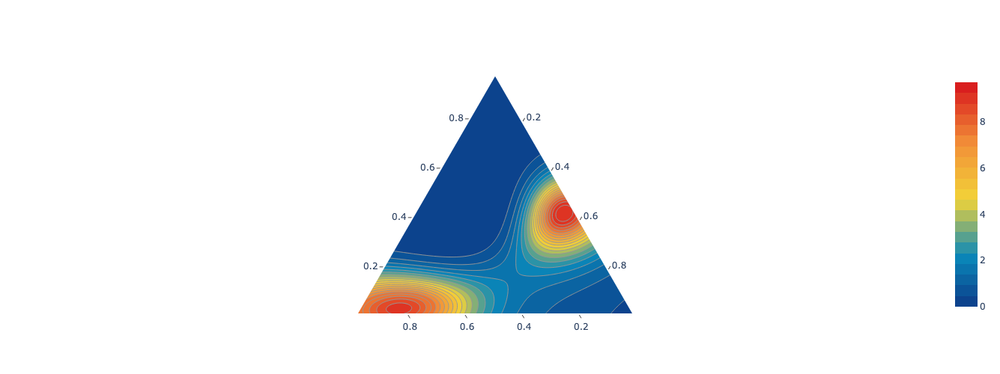

In [3]:
theta1 = np.array([3, 0, -4, 0, -26, 12]) 
 
true_fc1 = comp_exp_fam1(tg, theta1)

import plotly.figure_factory as ff

fig = ff.create_ternary_contour(np.array([C, A, B]), true_fc1,
                                   pole_labels=['', ' ', ''],
                                interp_mode='cartesian',
                                ncontours=20,
                                     colorscale='Portland' , showscale = True)



fig.show()

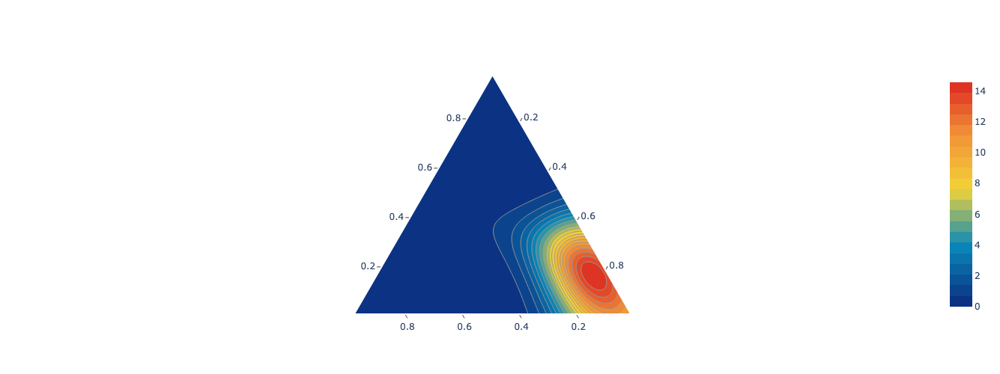

In [4]:
theta2 = np.array([-1,7,-2,-2,12,10]) 

true_fc2 = comp_exp_fam2(tg, theta2)

import plotly.figure_factory as ff

fig = ff.create_ternary_contour(np.array([C, A, B]), true_fc2,
                                   pole_labels=['', ' ', ''],
                                interp_mode='cartesian',
                                ncontours=20,
                                     colorscale='Portland' , showscale = True)
fig.show()

# Estimated density by bandwidth selector

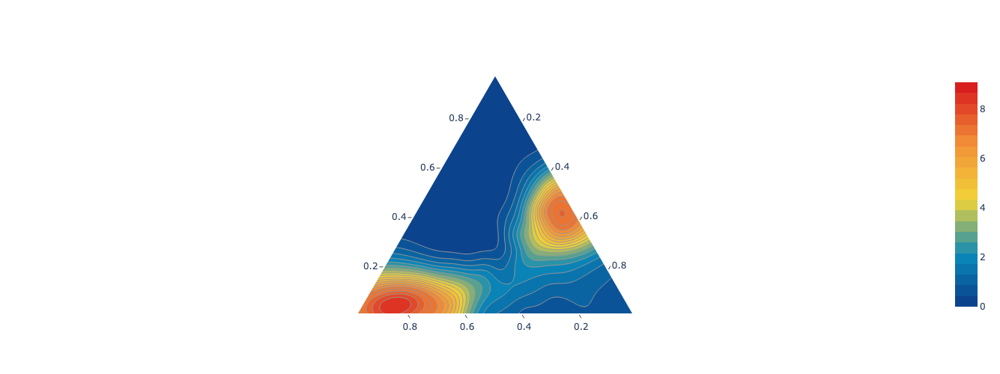

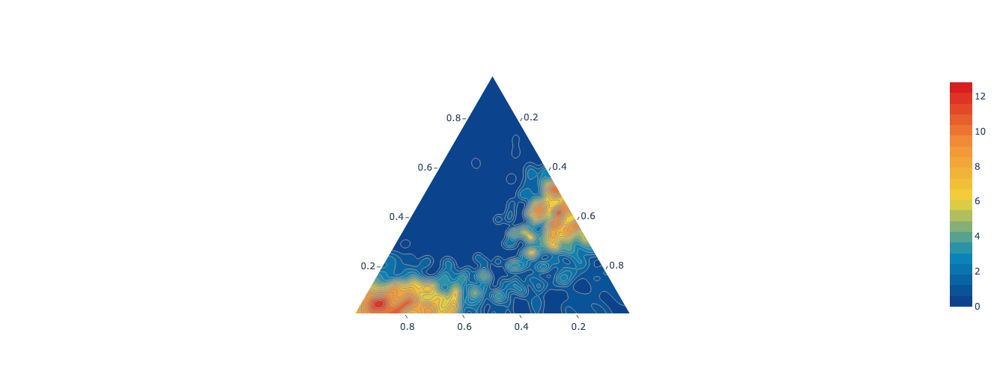

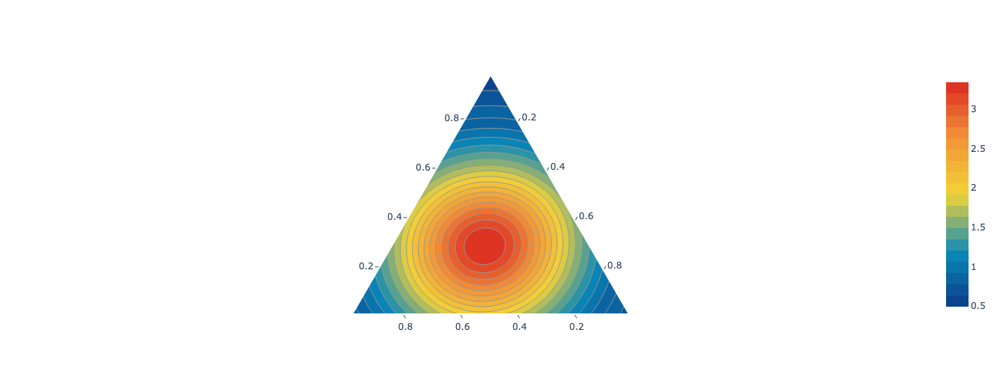

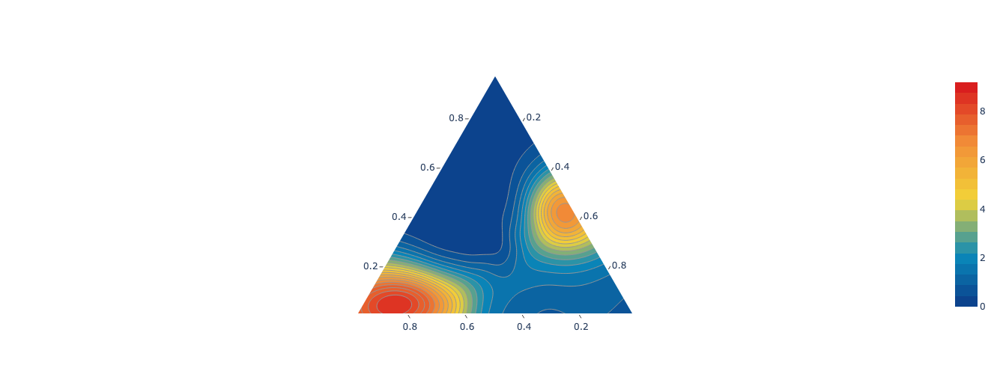

In [4]:
import pandas as pd

fc_dict = dict()  # theta1

import plotly.figure_factory as ff

for method in ['pl','ise','rot','adaptive']:

    fc_dict[method] = dict()

    fig_loc = './bandwidth/theta1/RSF_fc_' + method + '.csv'  
    # file directory

    fc_dict[method] = np.array(pd.read_csv(fig_loc, header = None)).flatten() # load estimated dens 

    fig = ff.create_ternary_contour(np.array([C, A, B]), fc_dict[method],
                                               pole_labels=['', ' ', ''],
                                            interp_mode='cartesian',
                                            ncontours=20,
                                                 colorscale='Portland',
                                        showscale = True)
    
    fig.show()
    
    fig.write_image("./img/bandwidth/theta1_" + method + ".png")

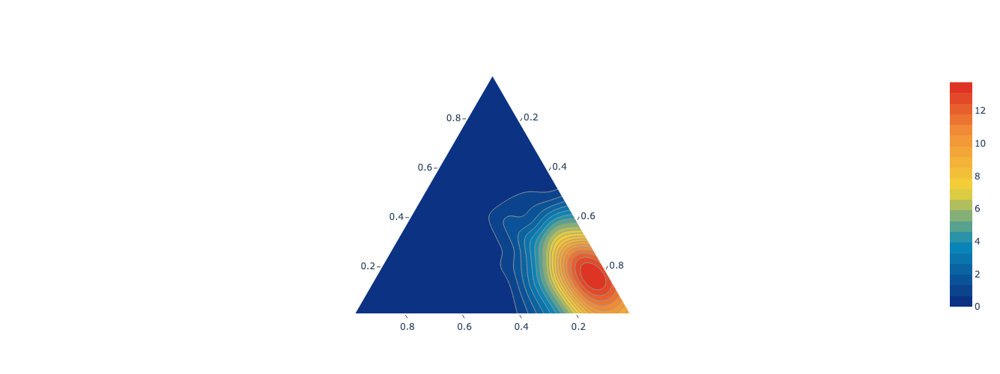

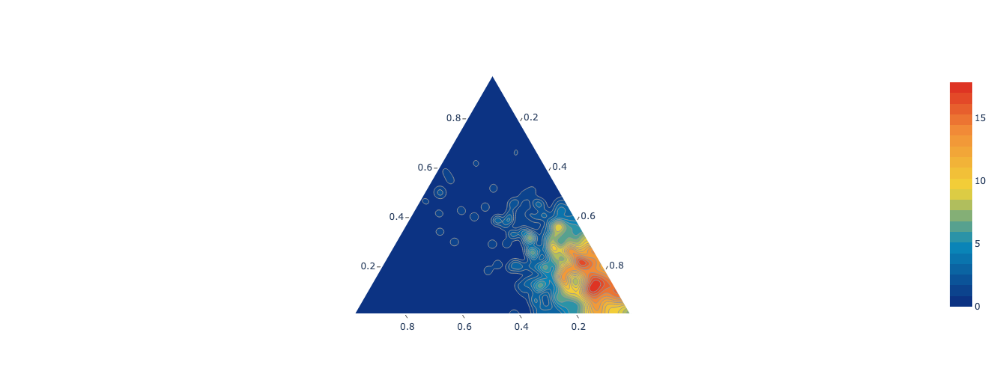

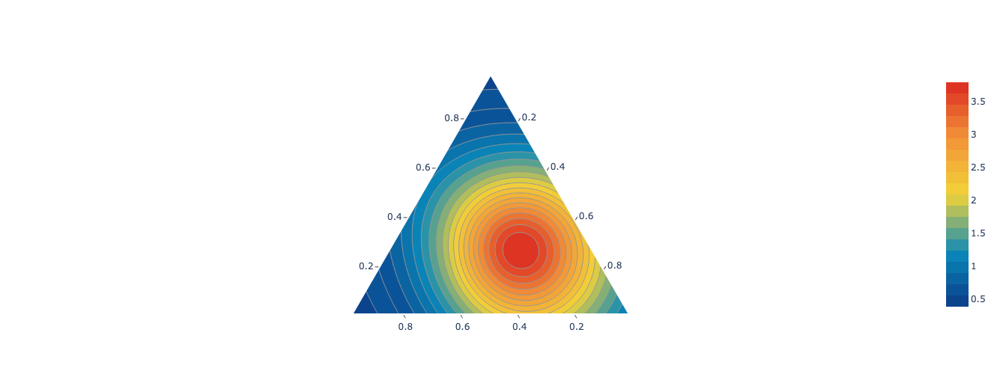

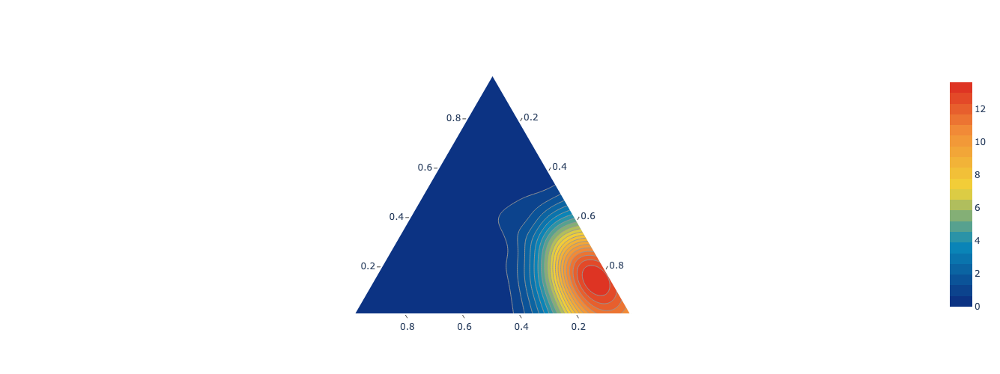

In [5]:
import pandas as pd

fc_dict = dict()  # theta2

for method in ['pl','ise','rot','adaptive']:

    fc_dict[method] = dict()

    fig_loc = './bandwidth/theta2/RSF_fc_' + method + '.csv'  
    # file directory

    fc_dict[method] = np.array(pd.read_csv(fig_loc, header = None)).flatten() # load estimated dens 

    fig = ff.create_ternary_contour(np.array([C, A, B]), fc_dict[method],
                                               pole_labels=['', ' ', ''],
                                            interp_mode='cartesian',
                                            ncontours=20,
                                                 colorscale='Portland',
                                        showscale = True)
    
    fig.show()
    
    fig.write_image("./img/bandwidth/theta2_" + method + ".png")

# Approximation of folding

In [2]:
import pandas as pd
import numpy as np

import plotly.figure_factory as ff
fig_loc = './approximation2/theta1/degree1_fc.csv'  
# file directory

fc = np.array(pd.read_csv(fig_loc, header = None)).flatten() # load estimated dens 

fig = ff.create_ternary_contour(np.array([C, A, B]), fc,
                                           pole_labels=['', ' ', ''],
                                        interp_mode='cartesian',
                                        ncontours=20,
                                             colorscale='Portland',
                                    showscale = True)

fig.show()

NameError: name 'C' is not defined

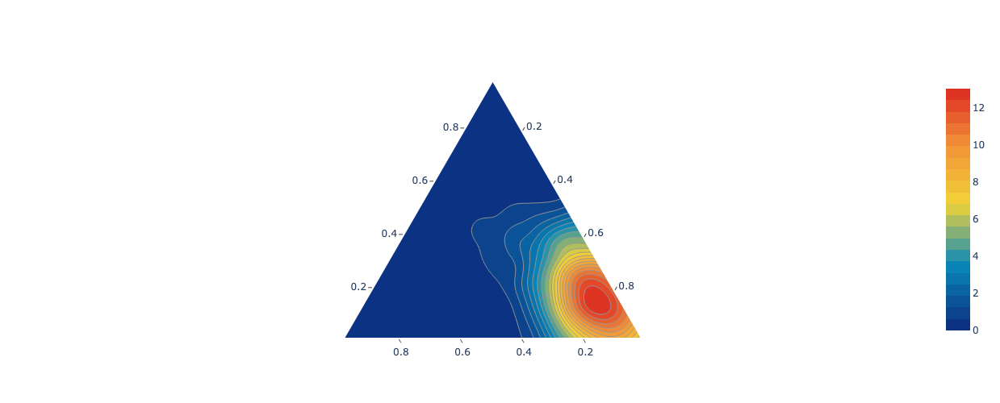

In [5]:
import pandas as pd

import plotly.figure_factory as ff
fig_loc = './approximation2/theta2/degree1_fc.csv'  
# file directory

fc = np.array(pd.read_csv(fig_loc, header = None)).flatten() # load estimated dens 

fig = ff.create_ternary_contour(np.array([C, A, B]), fc,
                                           pole_labels=['', ' ', ''],
                                        interp_mode='cartesian',
                                        ncontours=20,
                                             colorscale='Portland',
                                    showscale = True)

fig.show()

# Discontinuous density

In [6]:
import numpy as np

def piecewise_den(x):
    """
    x: numpy array of shape (n, 2)
    returns: numpy array of shape (n,)
    """
    n = x.shape[0]
    den = np.ones(n)

    a = (x[:, 0] + x[:, 1] <= 0.2)
    b = (x[:, 0] + x[:, 1] <= 0.5)

    den[b] = den[b] - 1 + (0.425 / 0.123)
    den[a] = den[a] - (0.425 / 0.123) + 10

    return den

In [7]:
true_fc = piecewise_den(tg)

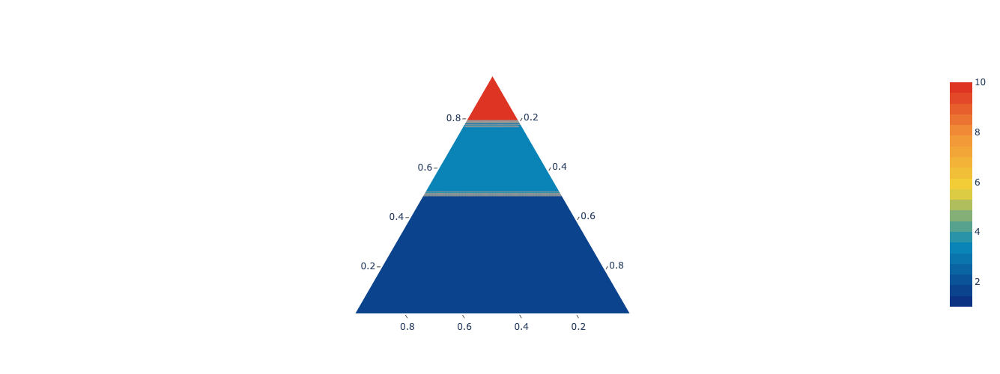

In [32]:
import plotly.figure_factory as ff

fig = ff.create_ternary_contour(np.array([C, A, B]), true_fc,
                                   pole_labels=['', ' ', ''],
                                interp_mode='cartesian',
                                ncontours=20,
                                     colorscale='Portland' , showscale = True)



fig.show()

fig.write_image("./img/discontinuous/true_density.png")

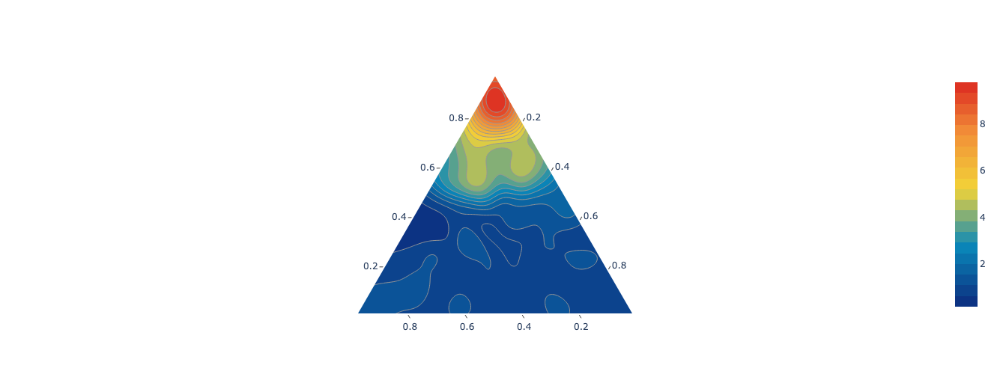

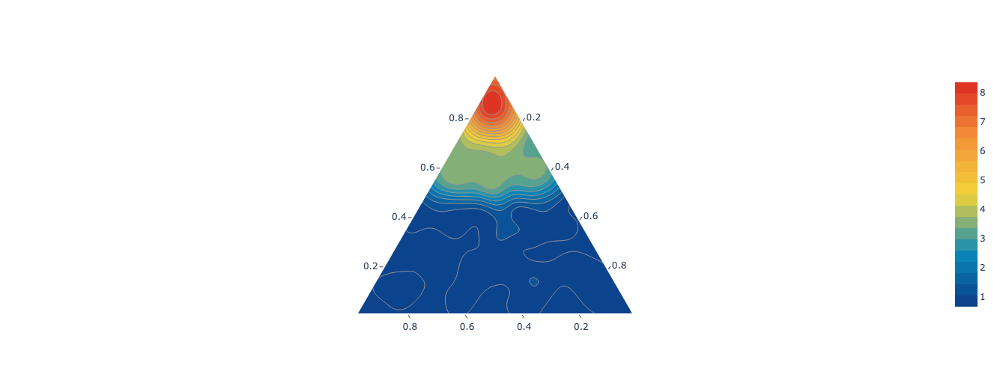

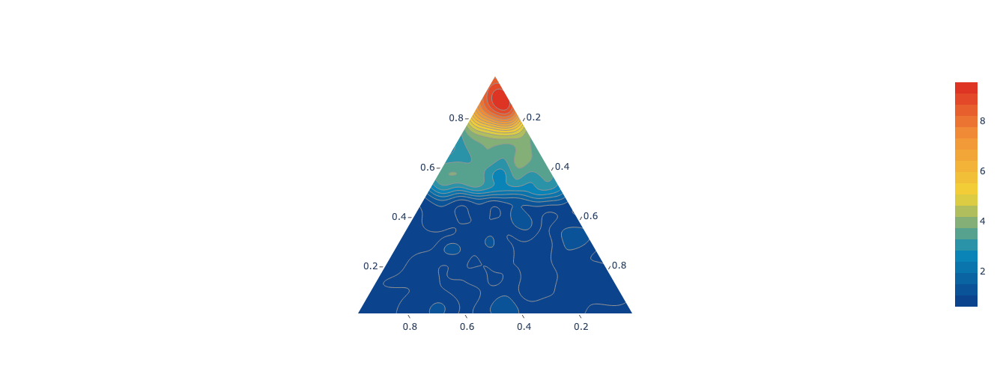

In [30]:
import pandas as pd # n_sample = 500

fc_dict = dict()  # theta1

for n_samples in ['500','1000','2000']:

    fc_dict[n_samples] = dict()

    fig_loc = './discontinuous/RSF_fc_' + n_samples + '.csv'  
    # file directory

    fc_dict[n_samples] = np.array(pd.read_csv(fig_loc, header = None)).flatten() # load estimated dens 

    fig = ff.create_ternary_contour(np.array([C, A, B]), fc_dict[n_samples],
                                               pole_labels=['', ' ', ''],
                                            interp_mode='cartesian',
                                            ncontours=20,
                                                 colorscale='Portland',
                                        showscale = True)
    
    fig.show()
    
    fig.write_image("./img/discontinuous/RSF_fc_" + n_samples + ".png")